# Self-Driving Car Engineer Nanodegree


### Advanced Lane Finding Project By Abdelkoddous Khamsi

The goals / steps of this project are the following:

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

---
## First, I'll compute the camera calibration using chessboard images

In [1]:
import numpy as np
import cv2
import glob
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import math

%matplotlib qt

# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('camera_cal/calibration*.jpg')
N = len(images)

print(images)
print(type(images))
print("Number of images ==>", N)

# Step through the list and search for chessboard corners
for fname in images:
    img = cv2.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        cv2.imshow('img',img)
        cv2.waitKey(1000)
    else:
        print("No corners found in ", fname)

cv2.destroyAllWindows()

['camera_cal\\calibration1.jpg', 'camera_cal\\calibration10.jpg', 'camera_cal\\calibration11.jpg', 'camera_cal\\calibration12.jpg', 'camera_cal\\calibration13.jpg', 'camera_cal\\calibration14.jpg', 'camera_cal\\calibration15.jpg', 'camera_cal\\calibration16.jpg', 'camera_cal\\calibration17.jpg', 'camera_cal\\calibration18.jpg', 'camera_cal\\calibration19.jpg', 'camera_cal\\calibration2.jpg', 'camera_cal\\calibration20.jpg', 'camera_cal\\calibration3.jpg', 'camera_cal\\calibration4.jpg', 'camera_cal\\calibration5.jpg', 'camera_cal\\calibration6.jpg', 'camera_cal\\calibration7.jpg', 'camera_cal\\calibration8.jpg', 'camera_cal\\calibration9.jpg']
<class 'list'>
Number of images ==> 20
No corners found in  camera_cal\calibration1.jpg
No corners found in  camera_cal\calibration4.jpg
No corners found in  camera_cal\calibration5.jpg


objpoints array len 17
imgpoints array len 17


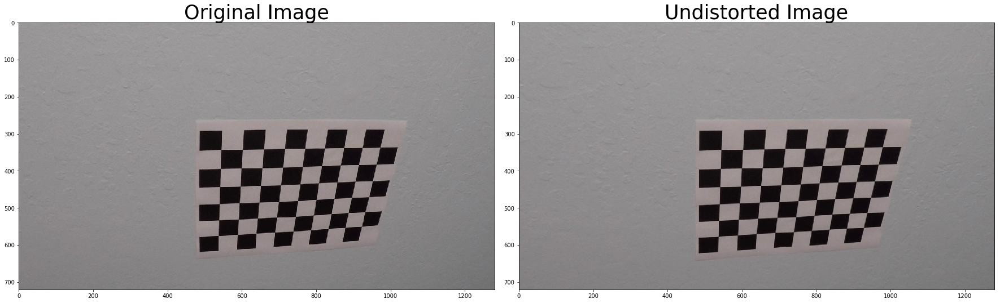

In [2]:
## Camera calibration given
%matplotlib inline

def cal_undistort(img, objpoints, imgpoints):
    # Use cv2.calibrateCamera() and cv2.undistort()
    cam_calib = cv2.calibrateCamera(objpoints, imgpoints, img.shape[:-1], None, None)
    undist = cv2.undistort(img, cam_calib[1], cam_calib[2])
    return undist

def PlotComparisonView(image_before, image_after, performedProcessing, colormap = (None, None)):
    """
    To avoid repeting ploting commands every time, will be useful throughout
    this notebook 
    """

    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(image_before, cmap = colormap[0])
    ax1.set_title('Original Image', fontsize=35)
    ax2.imshow(image_after, cmap = colormap[1])
    ax2.set_title(performedProcessing + ' Image', fontsize=35)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
    plt.show()

img = cv2.imread(images[1])

print("objpoints array len", len( objpoints))
print("imgpoints array len", len( imgpoints))

undistorted_img = cal_undistort(img, objpoints, imgpoints)

PlotComparisonView(img, undistorted_img, 'Undistorted')

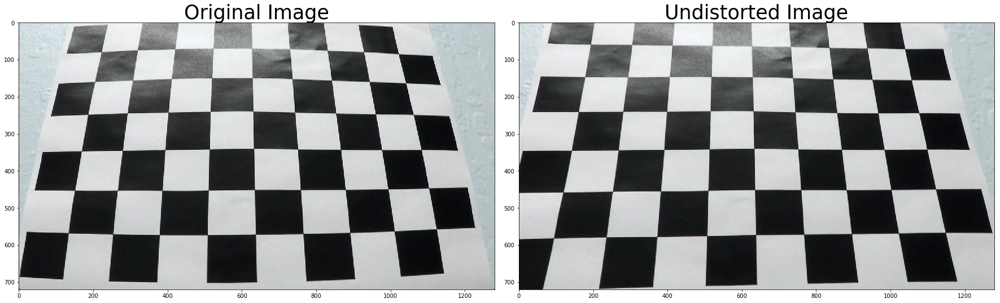

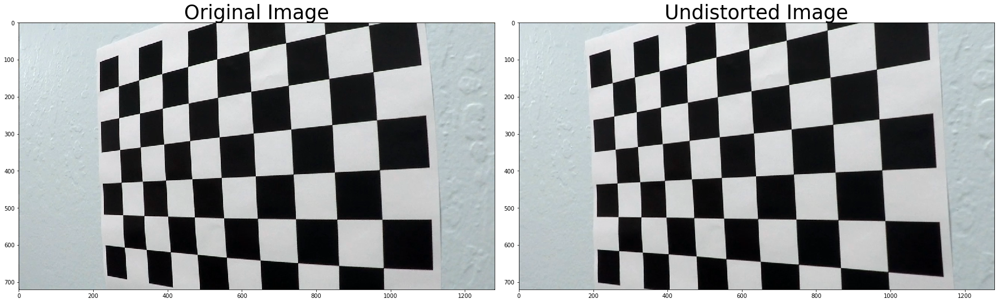

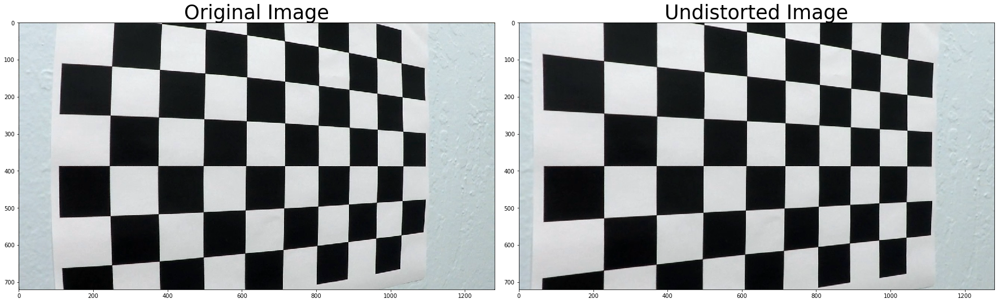

In [3]:
# Visualizing before and after of Undistortion on some chessboard images
for i in range(13,16):
    
    img = cv2.imread(images[i])
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    
    PlotComparisonView(img, undistorted_img, 'Undistorted')

## Then, I'll Apply a distortion correction to raw images

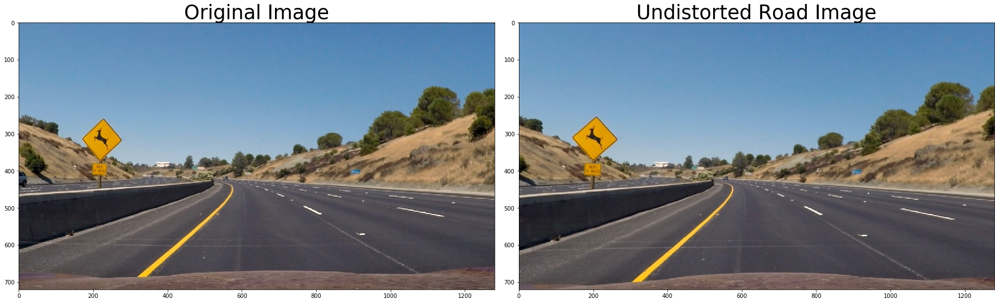

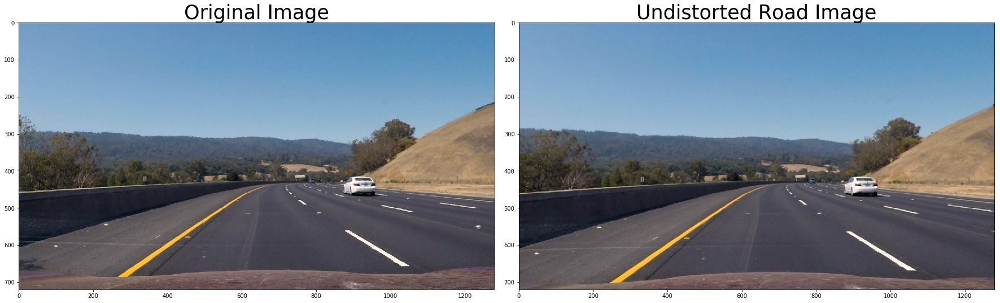

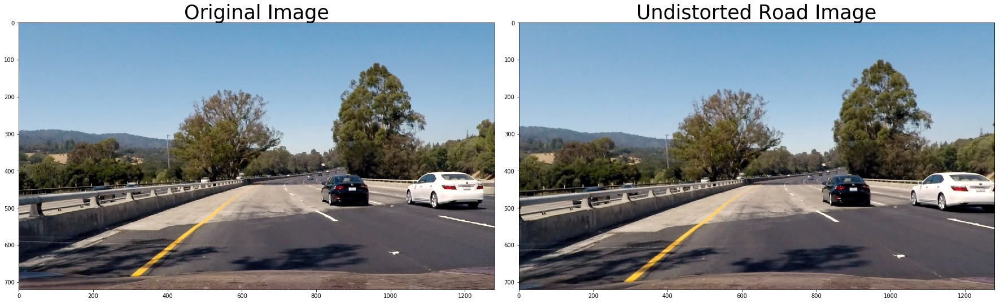

In [4]:
import matplotlib.image as mpimg

# Visualizing before and after of Undistortion on real world application image
test_images = glob.glob('test_images/test*.jpg')

for i in range(1,4):
    img = mpimg.imread(test_images[i])
    undistorted_img = cal_undistort(img, objpoints, imgpoints)
    PlotComparisonView(img, undistorted_img, 'Undistorted Road')

## I'll Use color transforms, gradients, etc., to create a thresholded binary image

* Let's start playing with the sobel operator

In [5]:
image = mpimg.imread(test_images[1])

In [6]:
def axis_gradient(img, ksize=9, thresh=(30,255)):
    ## x gradient

    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
    
    height = img.shape[0]
    width = img.shape[1]
    # derivative along x
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)

    abs_sobel = np.absolute(sobelx)

    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))

    single_axis_binary = np.zeros_like(gray_image, dtype=np.uint8)
    #single_axis_binary = np.zeros((height,width,1), np.uint8)

    single_axis_binary[ (scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return single_axis_binary#cv2.Canny(gray_image, 20, 50) #

def magnitude_gradient(img, ksize=9, thresh=(50,255),channel='gray'):
    ## mag gradient
    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
        
    # derivative along x and y
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)
    sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize)
    sobelxy = np.sqrt(sobelx**2 + sobely**2)

    scaled_sobel = np.uint8(255*sobelxy/np.max(sobelxy))

    mag_binary = np.zeros_like(gray_image)
    mag_binary[ (scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return mag_binary

def direction_gradient(img, ksize=9, thresh=(0.7,1.3),channel='gray'):
    ## direction gradient

    # convert to gray scale
    #if channel == 'gray':
    #    gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    #else:
    #    gray_image = img
    if len(img.shape) == 3:
        gray_image = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    elif len(img.shape) ==2:
        gray_image = img
        
    # derivative along x and y
    sobelx = cv2.Sobel(gray_image, cv2.CV_64F, 1, 0, ksize)
    sobely = cv2.Sobel(gray_image, cv2.CV_64F, 0, 1, ksize)
    
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)

    sobel_direction = np.arctan2(abs_sobely, abs_sobelx)

    dir_binary = np.zeros_like(sobel_direction)
    dir_binary[ (sobel_direction >= thresh[0]) & (sobel_direction <= thresh[1])] = 1

    return dir_binary


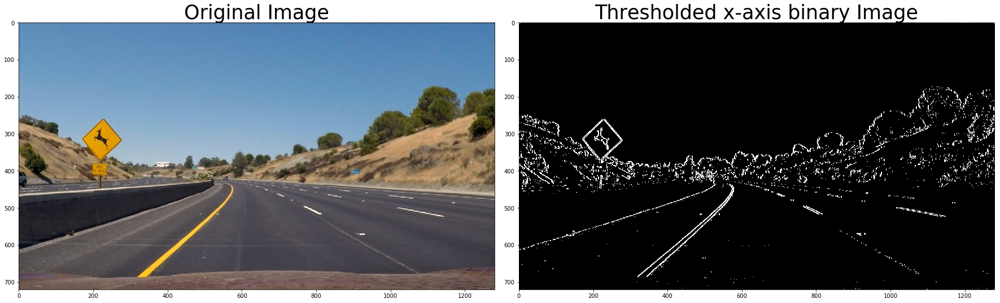

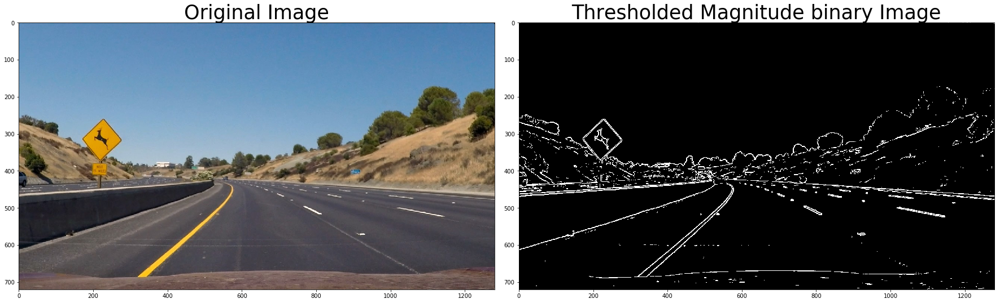

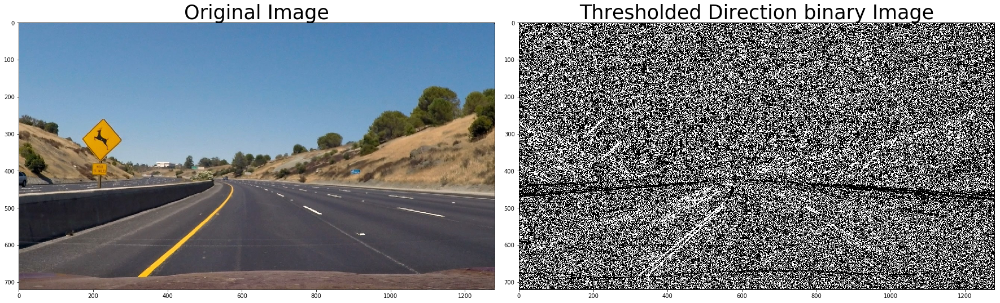

In [7]:

# Apply all three distinct gradient
axis_binary_output = axis_gradient(image)
mag_binary_output = magnitude_gradient(image)
dir_binary_output = direction_gradient(image)


PlotComparisonView(image, axis_binary_output, 'Thresholded x-axis binary', (None, 'gray'))
PlotComparisonView(image, mag_binary_output, 'Thresholded Magnitude binary', (None, 'gray'))
PlotComparisonView(image, dir_binary_output, 'Thresholded Direction binary', (None, 'gray'))

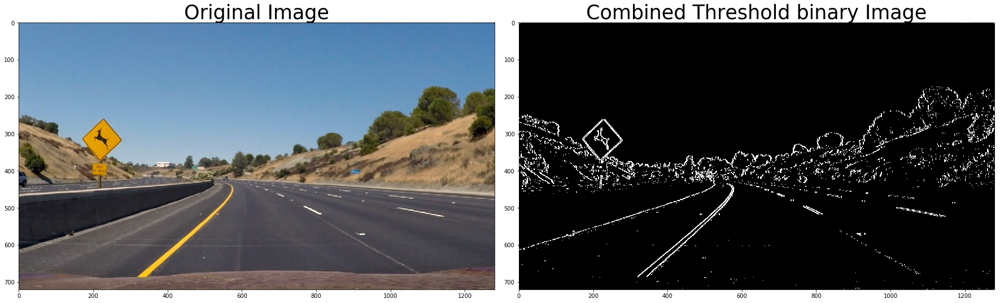

In [8]:
# Play with threshold combination
combined_binary = np.zeros_like(axis_binary_output)
combined_binary[ (axis_binary_output==1) | (mag_binary_output*dir_binary_output == 1) ] = 1

PlotComparisonView(image, combined_binary, 'Combined Threshold binary', (None, 'gray'))


In [9]:
def combinedGradient_thresholdedBinary(img):
    
    print("Image shape ==>",img.shape)
    axis_binary_output = axis_gradient(img)
    mag_binary_output = magnitude_gradient(img)
    dir_binary_output = direction_gradient(img)
    
    combined_binary = np.zeros_like(axis_binary_output)
    combined_binary[ (axis_binary_output==1) | (mag_binary_output*dir_binary_output == 1) ] = 1

    return combined_binary

Image shape ==> (720, 1280, 3)


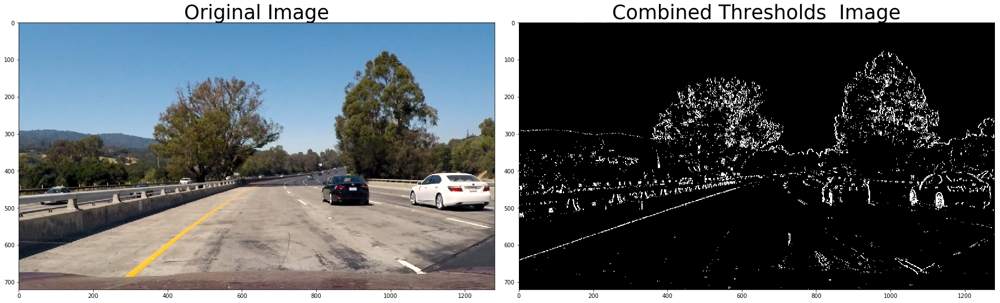

Image shape ==> (720, 1280, 3)


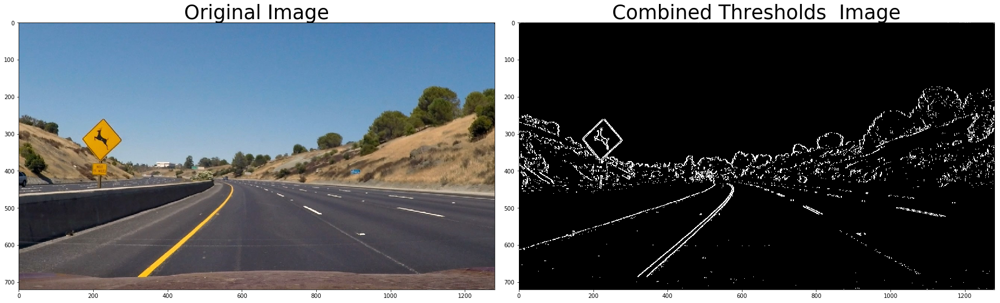

Image shape ==> (720, 1280, 3)


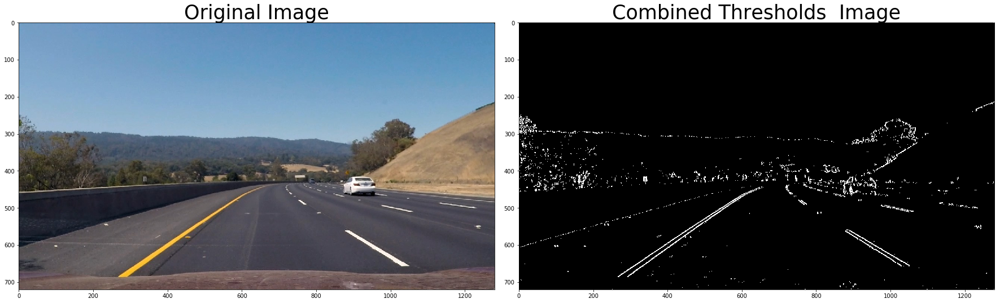

Image shape ==> (720, 1280, 3)


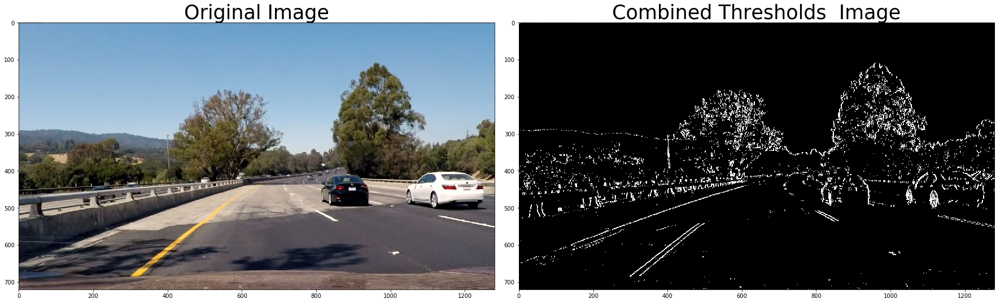

Image shape ==> (720, 1280, 3)


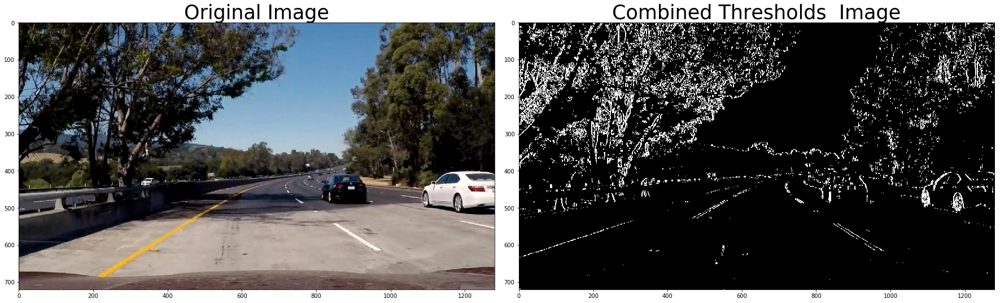

Image shape ==> (720, 1280, 3)


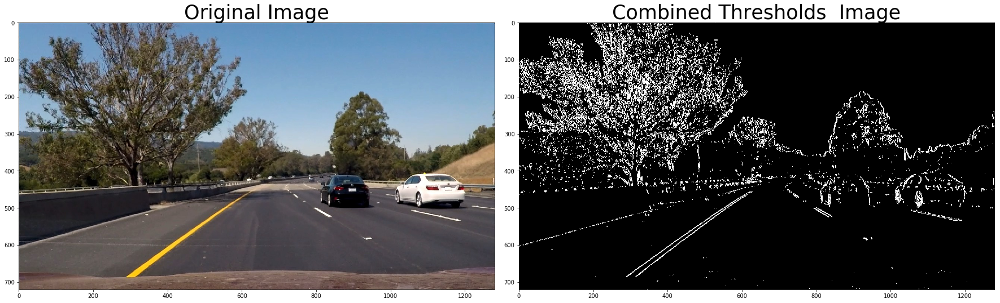

In [10]:
# Check on all the test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    
    combined_threshold = combinedGradient_thresholdedBinary(img)
    
    PlotComparisonView(img, combined_threshold, 'Combined Thresholds ', (None, 'gray'))
    
    cv2.imwrite("output_images/write_test"+str(i)+".jpg", combined_threshold)

    

* Let's start playing with color spaces

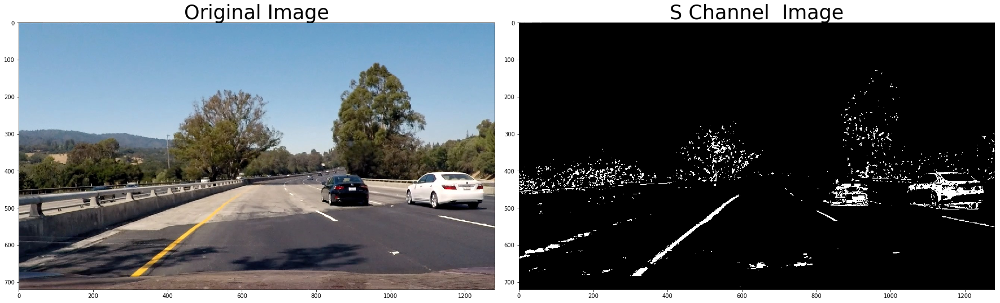

In [11]:
def to_S_Color_Channel(img, thresh=(150,255)):
    
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)

    S = hls[:,:,2]
    
    S_binary = np.zeros_like(S)
    S_binary[ ( S >= thresh[0] ) & ( S <= thresh[1] ) ] = 1
    
    return S_binary



image = mpimg.imread(test_images[3])
s_binary = to_S_Color_Channel(image,(150,255))

PlotComparisonView(image, s_binary, 'S Channel ', (None, 'gray'))


Image shape ==> (720, 1280)


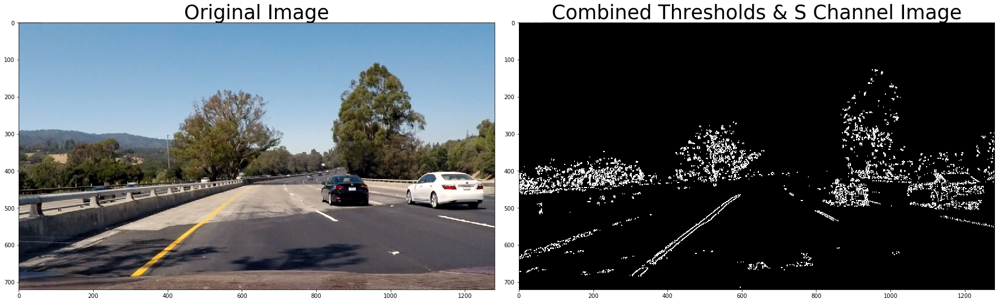

In [12]:
s_binary = to_S_Color_Channel(image)

combined_threshold = combinedGradient_thresholdedBinary(s_binary)

PlotComparisonView(image, combined_threshold, 'Combined Thresholds & S Channel', (None, 'gray'))

Image shape ==> (720, 1280)


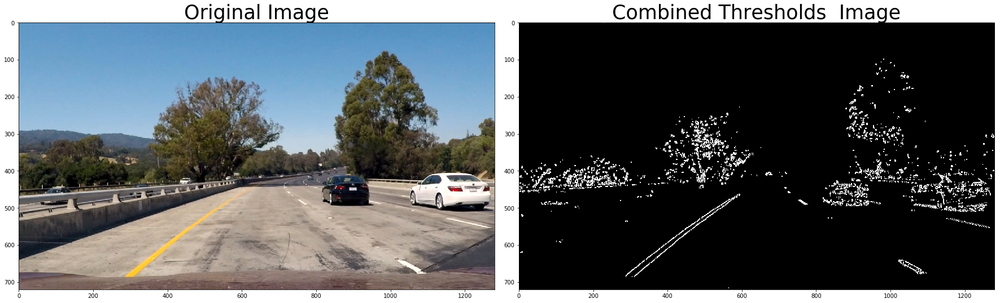

Image shape ==> (720, 1280)


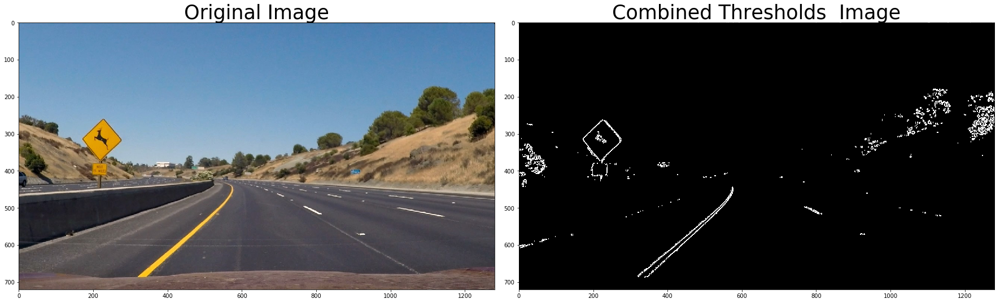

Image shape ==> (720, 1280)


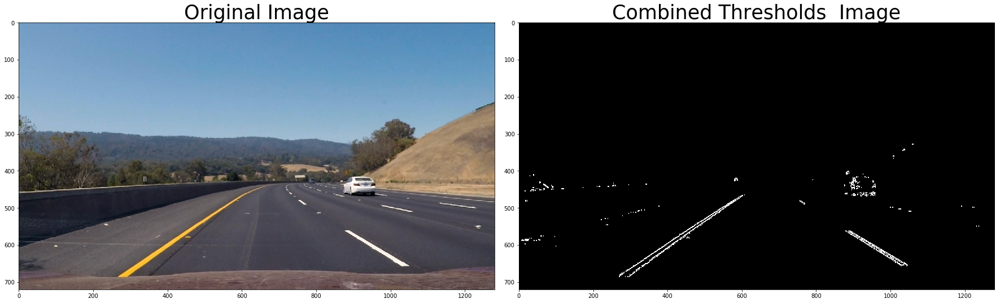

Image shape ==> (720, 1280)


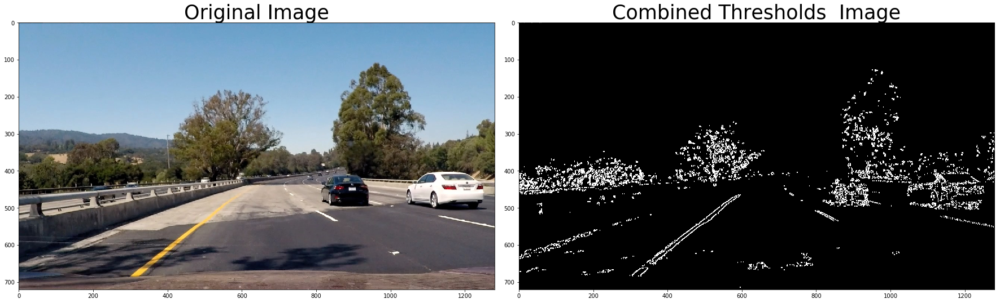

Image shape ==> (720, 1280)


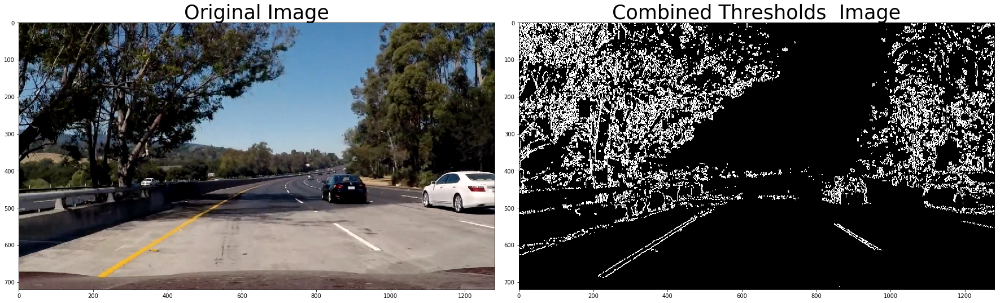

Image shape ==> (720, 1280)


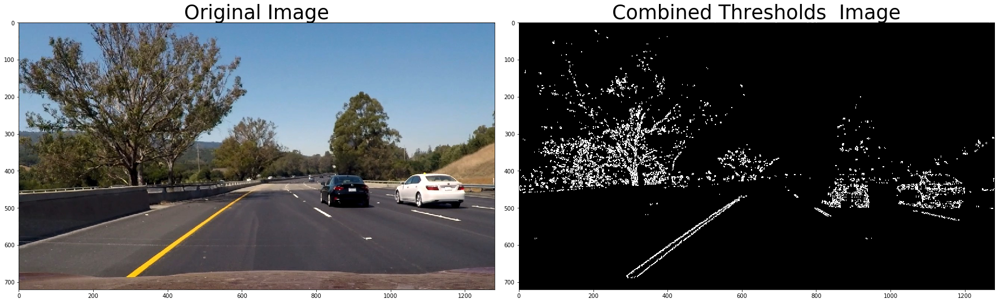

In [13]:
# Check on all the test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    
    s_binary = to_S_Color_Channel(img, (150,255))
    
    combined_threshold = combinedGradient_thresholdedBinary(s_binary)
    
    PlotComparisonView(img, combined_threshold, 'Combined Thresholds ', (None, 'gray'))


 ## I'll use now a perspective transform to rectify binary image ("birds-eye view")

In [14]:
def drawConvexPolygonEdgesVertices(img, pts, edge = True, vertex = True):
    """
    pts: a sequence of pts that create a convex polygon
    """
    col = [255, 0, 0]
    thick = 3
    rad = 15
    
    img_copy = img.copy() # avoid img_copy = img as both images will be modified 
    
    if vertex == True:
        # draw vertices
        for pt in pts:
            cv2.circle(img_copy, pt, rad, col, -thick, lineType=8, shift=0)
    
   
    if edge == True:
        # draw edges
        N = len(pts)
        for i in range(N):
            
            cv2.line(img_copy, pts[ i ], pts[ (i+1) % N ], col, thick)
    
    return img_copy



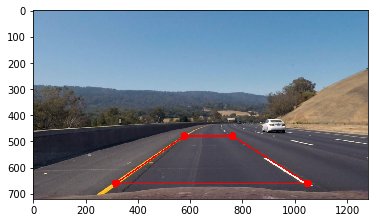

In [15]:
%matplotlib qt
image = mpimg.imread(test_images[2])
image = cal_undistort(image, objpoints, imgpoints)
img_size = ( image.shape[1], image.shape[0] )

# Manually selecting the cordinnates for a src points of RoI
src_p1 = (316,660)  # bottom left
src_p2 = (1050,660) # bottom right
src_p3 = (762,480)  # top right
src_p4 = (578,480)  # top left

src = np.float32([ src_p1, src_p2, src_p3, src_p4 ])

image_RoI = drawConvexPolygonEdgesVertices(image, [ src_p1, src_p2, src_p3, src_p4 ])

plt.imshow(image_RoI)
plt.show()

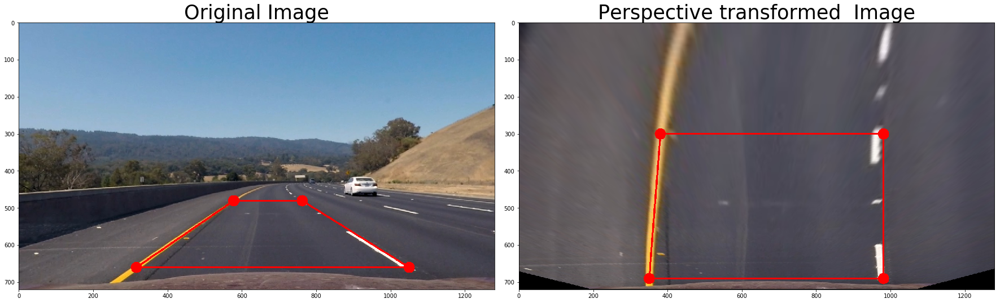

In [16]:
%matplotlib inline

height = image.shape[0]
width = image.shape[1]
# Manually selecting the cordinnates for a dst points of RoI
# need for a more reliable way to select src and dst points
dst_p1 = (350, height - 30)       # bottom left
dst_p2 = (width-300, height - 30) # bottom right
dst_p3 = (width-300, 300)         # top right
dst_p4 = (380, 300)               # top left

dst = np.float32([ dst_p1, dst_p2, dst_p3, dst_p4])

# generate perspective transofrmation matrix given source and destination points
M = cv2.getPerspectiveTransform(src, dst)

# perform perspective transformation
warped = cv2.warpPerspective(image, M, img_size, flags=cv2.INTER_LINEAR)

warped_RoI = drawConvexPolygonEdgesVertices(warped, [ dst_p1, dst_p2, dst_p3, dst_p4])

PlotComparisonView(image_RoI, warped_RoI, 'Perspective transformed ', colormap = (None, None))



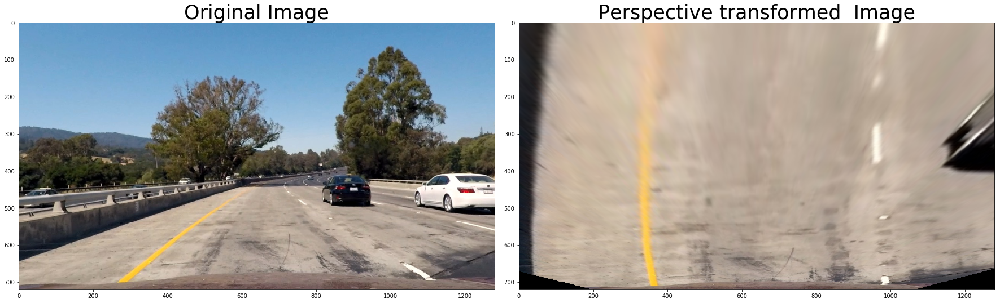

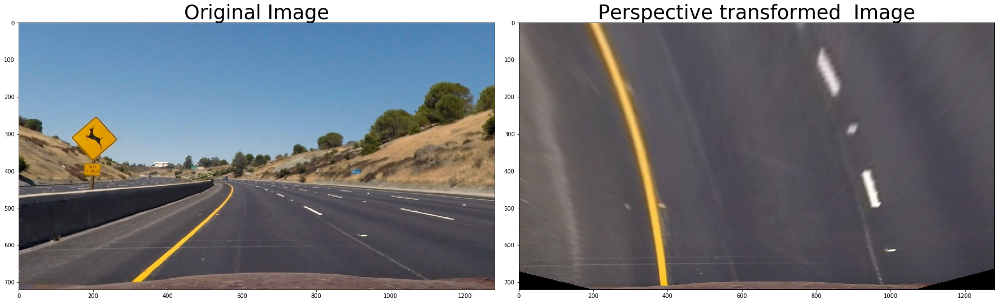

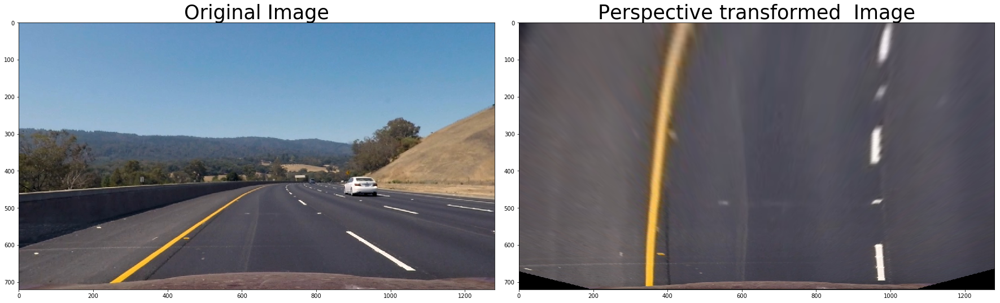

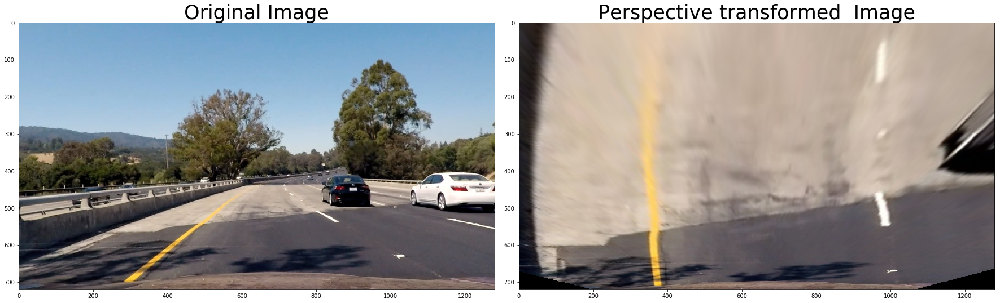

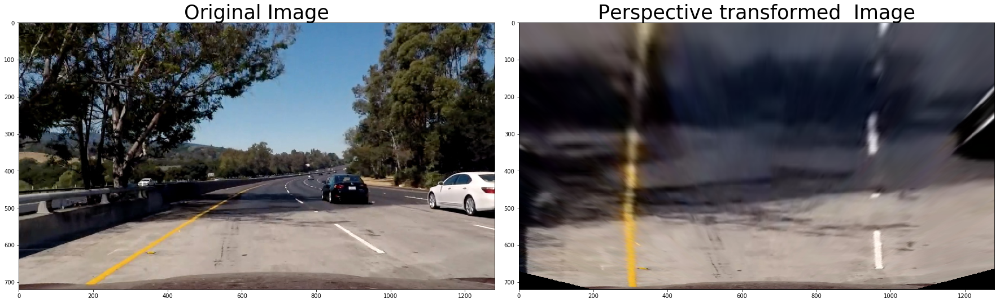

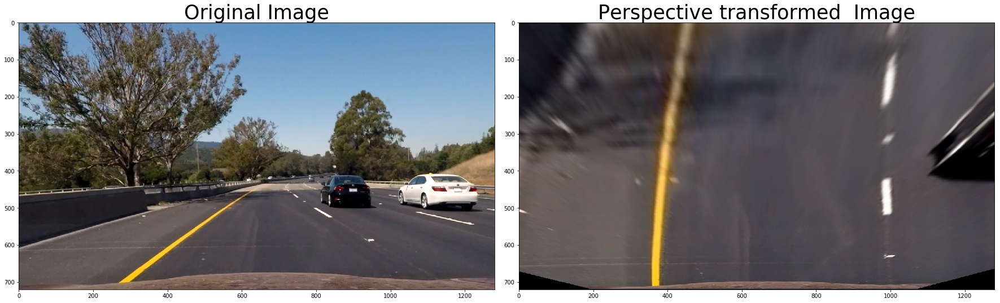

In [17]:
# Check result for all test images
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    undistort_img = cal_undistort(img, objpoints, imgpoints)

    warped_img = cv2.warpPerspective(undistort_img, M, img_size, flags=cv2.INTER_LINEAR)

    PlotComparisonView(undistort_img, warped_img, 'Perspective transformed ', (None, 'gray'))


Image shape ==> (720, 1280)


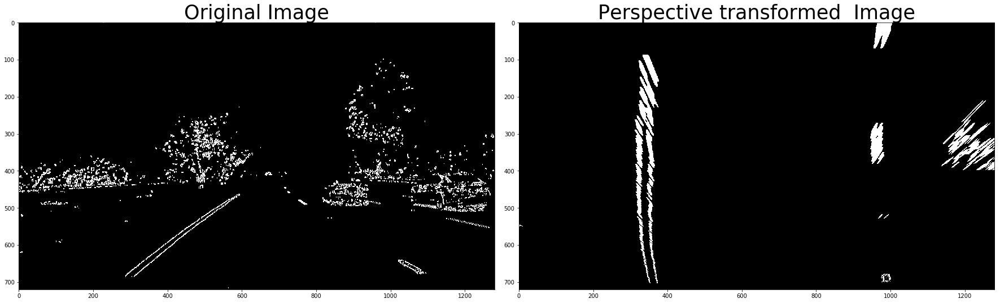

Image shape ==> (720, 1280)


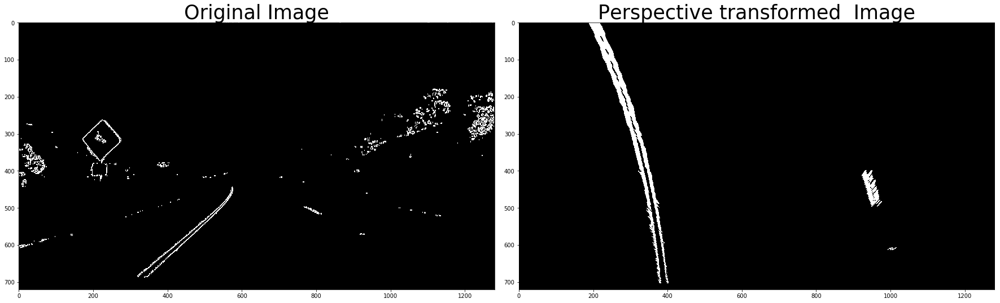

Image shape ==> (720, 1280)


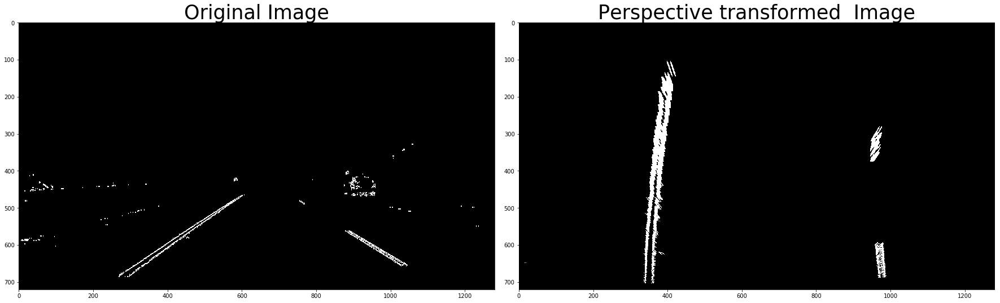

Image shape ==> (720, 1280)


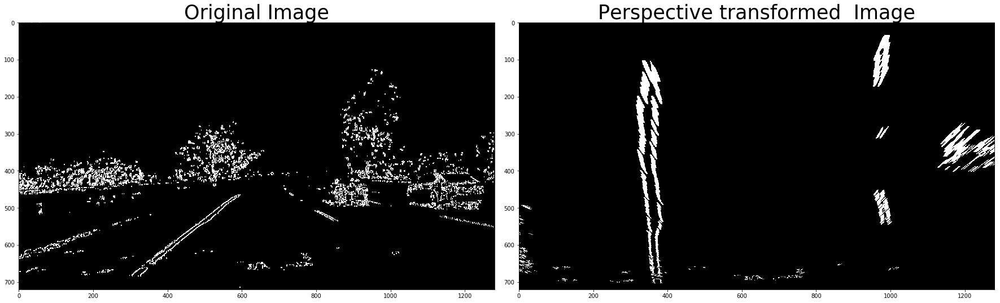

Image shape ==> (720, 1280)


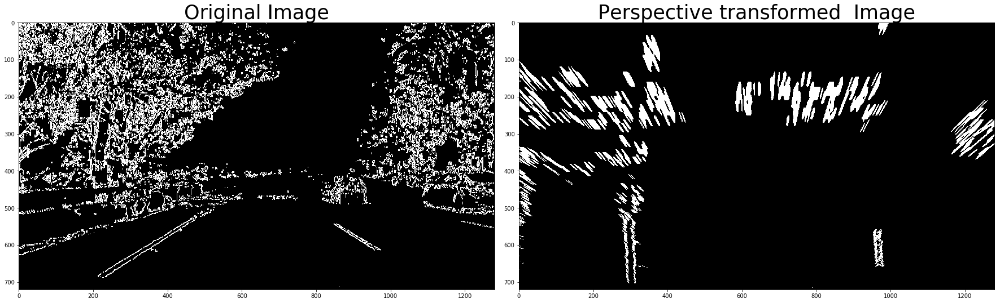

Image shape ==> (720, 1280)


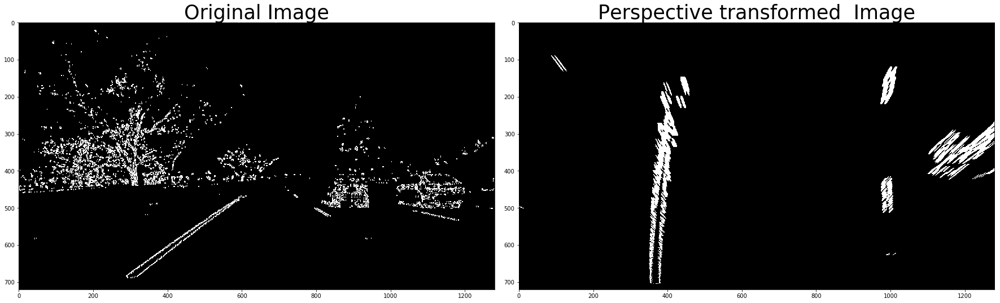

In [18]:
# Check result for all test binary images
test_warped_imgs = []
for i in range ( len(test_images) ):
    
    img = mpimg.imread(test_images[i])
    undistort_img = cal_undistort(img, objpoints, imgpoints)

    
    s_binary = to_S_Color_Channel(img, (150,255))
    
    combined_threshold = combinedGradient_thresholdedBinary(s_binary)
    
    warped_img = cv2.warpPerspective(combined_threshold, M, img_size, flags=cv2.INTER_LINEAR)
    test_warped_imgs += [warped_img]

    PlotComparisonView(combined_threshold, warped_img, 'Perspective transformed ', ('gray', 'gray'))


## Detect lane pixels and fit to find the lane boundary.

In [19]:
# reuse histogram from course material
def hist(img):
    # TO-DO: Grab only the bottom half of the image
    # Lane lines are likely to be mostly vertical nearest to the car

    height = img.shape[0]
    bottom_half = img[ height//2:,: ]

    # TO-DO: Sum across image pixels vertically - make sure to set `axis`
    # i.e. the highest areas of vertical lines should be larger values
    histogram = np.sum( bottom_half, axis=0)
    
    return histogram


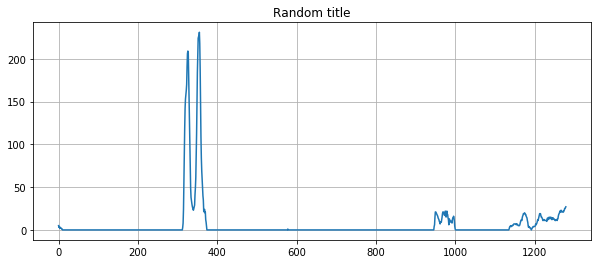

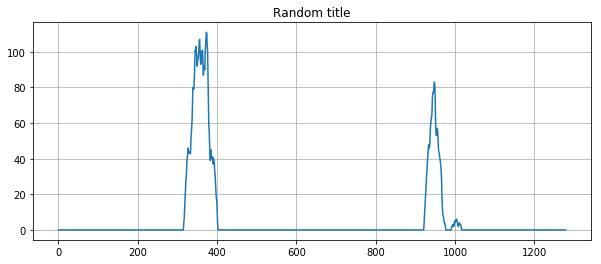

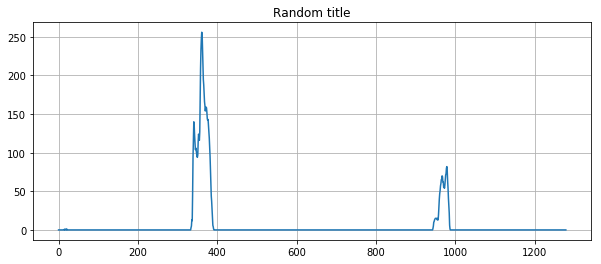

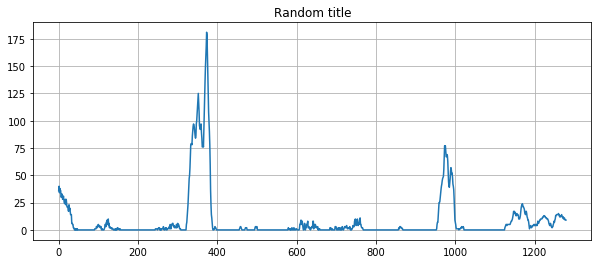

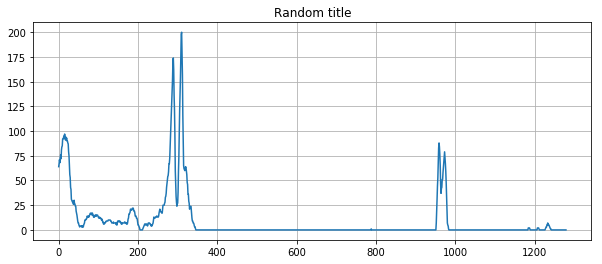

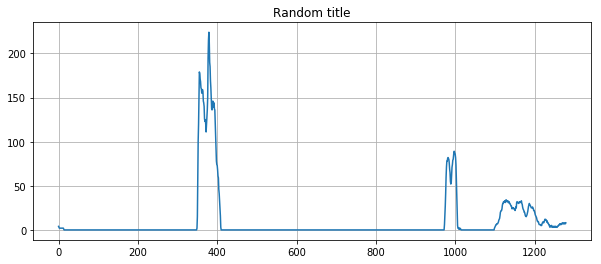

In [20]:
for i in range(6):
    # Create histogram of image binary activations
    histogram = hist(test_warped_imgs[i])

    # Visualize the resulting histogram
    fig = plt.figure(1, figsize=(10, 4))
    plt.title("Random title")
    plt.grid()
    plt.plot(histogram)
    plt.show()

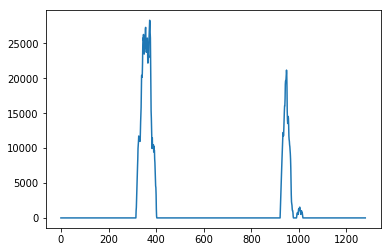

stacked image dimension (720, 1280, 3)
(1280,)
640
373 948
(array([  0,   0,   0, ..., 703, 703, 704], dtype=int64), array([188, 189, 190, ..., 400, 401, 396], dtype=int64))
615 0
new left base is ==> 383
1010 86
new left base is ==> 374
new right base is ==> 1003
1401 252
new left base is ==> 362
new right base is ==> 957
1551 1953
new left base is ==> 348
new right base is ==> 945
1762 18
new left base is ==> 329
1999 0
new left base is ==> 307
2146 0
new left base is ==> 281
2221 0
new left base is ==> 251
2275 0
new left base is ==> 220
Number of non zero pixels are in the whole image (17530,)
Number of non zero pixels indices on the left lane (14980,)
Number of non zero pixels indices on the right lane (2309,)
(720, 1280, 3)


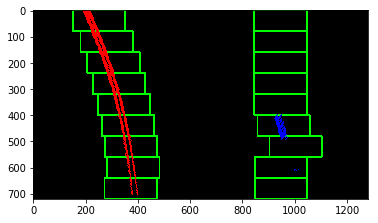

In [40]:
# HYPERPARAMETERS
# Choose the number of sliding windows
nwindows = 9
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50

test_im = test_warped_imgs[1]
if np.max(test_im) == 1:
    test_im = np.uint8(255*test_im)

histogram = hist(test_im)
plt.plot(histogram)
plt.show()

out_img = np.dstack((test_im, test_im, test_im))
print("stacked image dimension", out_img.shape)
# peak of left and right part of the histogram, starting points of left and right lanes
print(histogram.shape)
midpoint = np.int(histogram.shape[0]//2)
print(midpoint)

leftxbase = np.argmax(histogram[:midpoint])
rightxbase = np.argmax(histogram[midpoint:]) + midpoint
print(leftxbase, rightxbase)

# Set height of windows - based on nwindows above and image shape
window_height = np.int(test_im.shape[0]//nwindows)

# Identify the x and y positions of all nonzero pixels in the image
nonzero = test_im.nonzero()
print(nonzero)
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])

# Current positions to be updated later for each window in nwindows
leftx_current = leftxbase
rightx_current = rightxbase

# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = test_im.shape[0] - (window+1)*window_height
    win_y_high = test_im.shape[0] - window*window_height
    ### TO-DO: Find the four below boundaries of the window ###
    win_xleft_low = leftx_current - margin  # Update this
    win_xleft_high = leftx_current + margin  # Update this
    win_xright_low = rightx_current - margin  # Update this
    win_xright_high = rightx_current + margin  # Update this

    #Identify the nonzero pixels in x and y within the window
    left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                           & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]
    
    right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                           & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]
    
    print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                               # the left & right line in current window
    left_lane_inds.append(left_nonzero_pixels) 
    right_lane_inds.append(right_nonzero_pixels) 
    
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)
    
    # recalculating the base x-coordinates of left and right windows
    if (len(left_nonzero_pixels) > minpix):
        leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
        leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
        print("new left base is ==>", leftx_current)
    
    if ( len( right_nonzero_pixels ) > minpix):
        rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
        rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
        print("new right base is ==>", rightx_current)
    

left_lane_inds = np.concatenate( left_lane_inds )
right_lane_inds = np.concatenate( right_lane_inds )
print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line


# get pixel position from pixel indices
leftx_pos = nonzerox[left_lane_inds]
lefty_pos = nonzeroy[left_lane_inds]
rightx_pos = nonzerox[right_lane_inds]
righty_pos = nonzeroy[right_lane_inds]

out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
out_img[ righty_pos, rightx_pos] = [0, 0, 255] 

plt.imshow(out_img)
print(out_img.shape)

In [68]:


def detectLanePixels(test_im, stats=True):
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 9
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    
    # Make sure image values are in [0, 255] interval
    if np.max(test_im) == 1:
        test_im = np.uint8(255*test_im)
    
    # Create a histogram for the second half of the image
    histogram = hist(test_im)

    # Create output image to draw on and visualize result
    out_img = np.dstack((test_im, test_im, test_im))

    # peak of left and right part of the histogram are starting points of left and right lanes
    midpoint = np.int(histogram.shape[0]//2)
    leftxbase = np.argmax(histogram[:midpoint])
    rightxbase = np.argmax(histogram[midpoint:]) + midpoint


    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(test_im.shape[0]//nwindows)

    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = test_im.nonzero() # nonzero is a 2-elements tuple
    nonzeroy = np.array(nonzero[0]) # first element is an array of y coordinates of non-zero pixels
    nonzerox = np.array(nonzero[1]) # second element is an array of x coordinates of non-zero pixels

    # Current positions to be updated later for each window in nwindows
    leftx_current = leftxbase
    rightx_current = rightxbase

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []
    
    # This list is only for a general stat purpose
    activatedPixels_perWindow = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = test_im.shape[0] - (window+1)*window_height
        win_y_high = test_im.shape[0] - window*window_height

        #Find the four boundaries of the left & right windows on x axis 
        win_xleft_low = leftx_current - margin  
        win_xleft_high = leftx_current + margin 
        win_xright_low = rightx_current - margin  
        win_xright_high = rightx_current + margin

        #Identify the nonzero pixels in x and y within the window
        left_nonzero_pixels = ( (nonzerox > win_xleft_low) & (nonzerox < win_xleft_high)
                               & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

        right_nonzero_pixels = ( (nonzerox > win_xright_low) & (nonzerox < win_xright_high)
                               & (nonzeroy > win_y_low) & (nonzeroy < win_y_high) ).nonzero()[0]

        #print(len(left_nonzero_pixels), len(right_nonzero_pixels)) # How many non zero pixels indices are on 
                                                                   # the left & right line in current window
        activatedPixels_perWindow.insert(0,[len(left_nonzero_pixels), len(right_nonzero_pixels)])    
        
        # add the result to the one from previous windows
        left_lane_inds.append(left_nonzero_pixels) 
        right_lane_inds.append(right_nonzero_pixels) 

        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low), (win_xleft_high,win_y_high),(0,255,0), 5) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 5)

        # recalculating the base x-coordinates of left and right windows
        if (len(left_nonzero_pixels) > minpix):
            # Position of activated pixels in current left window
            leftx_pixelpos_current = nonzerox[left_nonzero_pixels]
            leftx_current = np.int(np.mean( leftx_pixelpos_current, axis=0) )
            #print("new left base is ==>", leftx_current)

        if ( len( right_nonzero_pixels ) > minpix):
            # Position of activated pixels in current right window
            rightx_pixelpos_current = nonzerox[right_nonzero_pixels]
            rightx_current = np.int(np.mean( rightx_pixelpos_current, axis=0) )
            #print("new right base is ==>", rightx_current)

    # reorganise indices across all windows
    left_lane_inds = np.concatenate( left_lane_inds )
    right_lane_inds = np.concatenate( right_lane_inds )
    
    if stats == True:
        print("leftxbase : ", leftxbase, 'rightxbase : ', rightxbase)
        print("Number of non zero pixels are in the whole image", nonzero[0].shape) #how many non zero pixels are in the whole image
        print("Number of non zero pixels indices on the left lane", left_lane_inds.shape) # how many non zero pixels indices are on the left line
        print("Number of non zero pixels indices on the right lane", right_lane_inds.shape) # how many non zero pixels indices are on the right line
        print("Number of activated pixels per window", np.array(activatedPixels_perWindow) )

    # get pixel position from pixel indices
    leftx_pos = nonzerox[left_lane_inds]
    lefty_pos = nonzeroy[left_lane_inds]
    rightx_pos = nonzerox[right_lane_inds]
    righty_pos = nonzeroy[right_lane_inds]

    out_img[ lefty_pos, leftx_pos] = [255, 0, 0]
    out_img[ righty_pos, rightx_pos] = [0, 0, 255]
    
    return leftx_pos, lefty_pos, rightx_pos, righty_pos, out_img



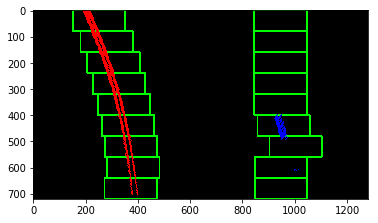

In [69]:
test_img = test_warped_imgs[1]

lane_pixel_img = detectLanePixels(test_img, stats=False)[4]

plt.imshow(lane_pixel_img)
plt.show()

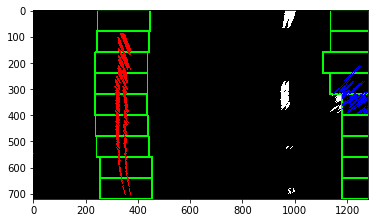

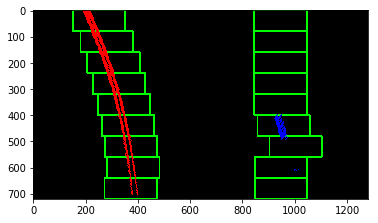

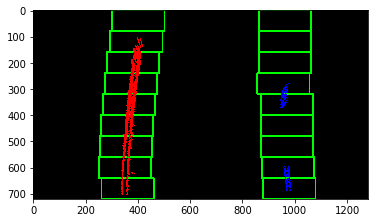

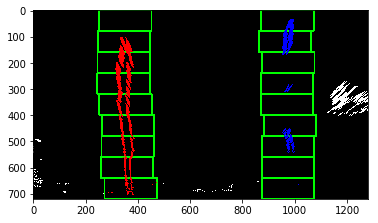

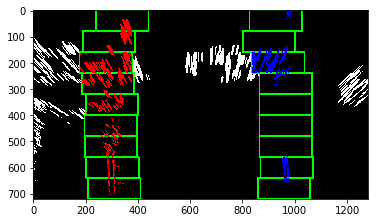

In [71]:
# Apply on all test images
for i in range(5):
    test_img = test_warped_imgs[i]

    lane_pixel_img = detectLanePixels(test_img, stats=False)[4]

    plt.imshow(lane_pixel_img)
    plt.show()

In [154]:
def fit_polynomial_toLane(image):
    
    # fit a polynomial into the detected pixels so far
    test_img = test_warped_imgs[5]
    leftx, lefty, rightx, righty, lanePixel_im = detectLanePixels(image, stats=False)

    # fitting into a 2nd order polynomial x = f(y)
    leftfit = np.polyfit( lefty, leftx, 2 )
    rightfit = np.polyfit( righty, rightx, 2)

    # Use the fitting parameters to plot the polynomial on the image
    ## generate y axis base 
    ploty = np.linspace(0, image.shape[0]-1, image.shape[0]).astype(int)
    ## compute leftx = f_left(y) & rightx = f_right(y)
    plot_leftx = ( leftfit[0]*ploty**2 + leftfit[1]*ploty + leftfit[2] ).astype(int)
    plot_rightx = ( rightfit[0]*ploty**2 + rightfit[1]*ploty + rightfit[2] ).astype(int)
    
    # plot left and right fitting on lanePixel_im
    plt.plot( plot_leftx, ploty, color='yellow' )
    plt.plot( plot_rightx, ploty, color='yellow')
    
    #print(ploty)
    #print(plot_rightx)
    #lanePixel_im[ ploty, plot_leftx] = [255, 255, 0] # will be painting only a single pixel per y value => not very visible
    #lanePixel_im[ ploty, plot_rightx] = [255, 255, 0]

    return lanePixel_im

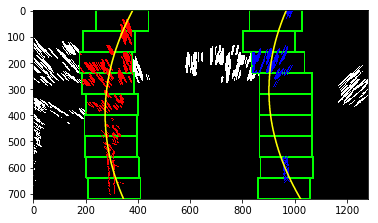

In [155]:
# Run on a single test image
test_img = test_warped_imgs[4]

out_img = fit_polynomial_toLane(test_img)
plt.imshow(out_img)
plt.show()


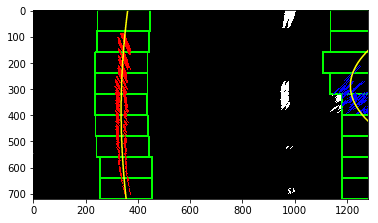

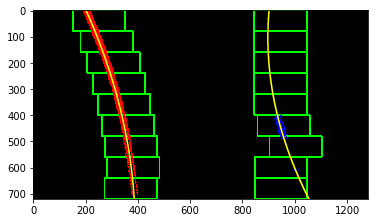

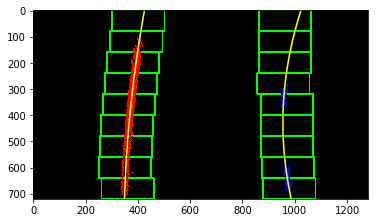

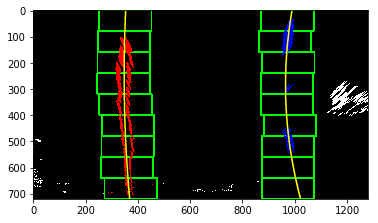

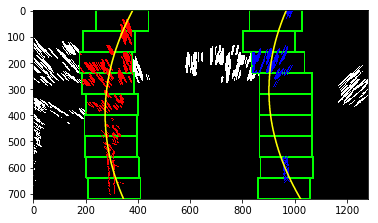

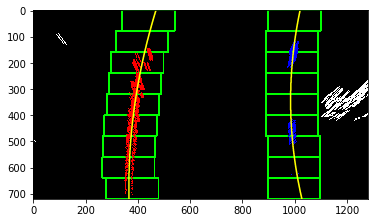

In [157]:
# Let's run on all 6 images
for i in range(6):
    
    current_test_img = test_warped_imgs[i]

    current_out_img = fit_polynomial_toLane(current_test_img)
        
    plt.imshow(current_out_img)
    plt.show()


